#Online Payments Fraud Detection









Connecting Google Colab to Kaggle to get Dataset directly to colab

In [ ]:
! mkdir ~/.kaggle
!cp /content/drive/MyDrive/kaggle_datasets/kaggle.json ~/.kaggle/kaggle.json
!chmod 600 ~/.kaggle/kaggle.json


In [ ]:
!kaggle datasets download -d jainilcoder/online-payment-fraud-detection

 98% 175M/178M [00:06<00:00, 39.3MB/s]
100% 178M/178M [00:06<00:00, 28.7MB/s]


Downloading the helper functions designed by mrdbourke which contains custom functions

In [ ]:
!wget https://raw.githubusercontent.com/mrdbourke/tensorflow-deep-learning/main/extras/helper_functions.py

--2022-11-26 02:36:15--  https://raw.githubusercontent.com/mrdbourke/tensorflow-deep-learning/main/extras/helper_functions.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 10246 (10K) [text/plain]
Saving to: ‘helper_functions.py’

helper_functions.py 100%[===================>]  10.01K  --.-KB/s    in 0s      

2022-11-26 02:36:15 (106 MB/s) - ‘helper_functions.py’ saved [10246/10246]



Installing pycaret library

In [16]:
!pip install --pre pycaret

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 487 kB 14.8 MB/s 
     |████████████████████████████████| 72 kB 807 kB/s 
     |████████████████████████████████| 7.0 MB 75.2 MB/s 
     |████████████████████████████████| 3.3 MB 88.5 MB/s 
     |████████████████████████████████| 79.9 MB 124 kB/s 
  Using cached matplotlib-3.5.3-cp37-cp37m-manylinux_2_5_x86_64.manylinux1_x86_64.whl (11.2 MB)
  Using cached requests-2.28.1-py3-none-any.whl (62 kB)
     |████████████████████████████████| 1.4 MB 36.5 MB/s 
  Using cached scikit_plot-0.3.7-py3-none-any.whl (33 kB)
  Using cached pyod-1.0.6.tar.gz (141 kB)
  Using cached lightgbm-3.3.3-py3-none-manylinux1_x86_64.whl (2.0 MB)
     |████████████████████████████████| 44 kB 2.6 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 106 kB 66.9

Installing model deployment library

In [28]:
!pip install gradio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached gradio-3.11.0-py3-none-any.whl (11.6 MB)
     |████████████████████████████████| 106 kB 19.8 MB/s 
  Using cached uvicorn-0.20.0-py3-none-any.whl (56 kB)
     |████████████████████████████████| 84 kB 2.7 MB/s 
  Using cached fastapi-0.87.0-py3-none-any.whl (55 kB)
     |████████████████████████████████| 213 kB 74.0 MB/s 
     |████████████████████████████████| 2.3 MB 72.3 MB/s 
     |████████████████████████████████| 54 kB 3.5 MB/s 
     |████████████████████████████████| 84 kB 3.5 MB/s 
     |████████████████████████████████| 64 kB 2.9 MB/s 
     |████████████████████████████████| 80 kB 8.9 MB/s 
     |████████████████████████████████| 68 kB 5.1 MB/s 
     |████████████████████████████████| 68 kB 5.6 MB/s 
     |████████████████████████████████| 68 kB 5.9 MB/s 
     |████████████████████████████████| 68 kB 4.7 MB/s 
     |████████████████████████████████| 46 kB 3.5 MB/s 
 

In [22]:
!pip install autoviz

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached autoviz-0.1.58-py3-none-any.whl (64 kB)
  Using cached emoji-2.2.0.tar.gz (240 kB)
  Using cached hvplot-0.8.2-py2.py3-none-any.whl (3.2 MB)
  Using cached bokeh-2.4.3-py3-none-any.whl (18.5 MB)
  Using cached pyamg-4.2.3-cp37-cp37m-manylinux_2_12_x86_64.manylinux2010_x86_64.whl (1.7 MB)
  Using cached jupyter-1.0.0-py2.py3-none-any.whl (2.7 kB)
  Using cached panel-0.12.7-py2.py3-none-any.whl (12.9 MB)
     |████████████████████████████████| 121 kB 15.3 MB/s 
     |████████████████████████████████| 83 kB 1.9 MB/s 
  Created wheel for emoji: filename=emoji-2.2.0-py3-none-any.whl size=234926 sha256=0c545efd91ca8f53bdf433abb4b2e17e1ece771e8068a0727fd0617a509c0c66
  Stored in directory: /root/.cache/pip/wheels/f3/e3/f2/1de1c2e3ed742e1df73e0f15d58864e50c7e64f607b548d6cf
Successfully built emoji
  Attempting uninstall: bokeh
    Found existing installation: bokeh 2.3.3
    Unins

Installing Specific version of matplotlib

In [33]:
!python -m pip uninstall matplotlib
!pip install matplotlib==3.4.3

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 10.3 MB 13.4 MB/s 


Importing required functions from helper functions

In [2]:
from helper_functions import unzip_data

unziping the dataset

In [7]:
unzip_data('online-payment-fraud-detection.zip')

Importing required libraries

In [1]:
import pandas as pd
import numpy as np
from pycaret.classification import *
import matplotlib.pyplot as plt
%matplotlib inline

In [3]:
df = pd.read_csv("onlinefraud.csv")

In [4]:
df.head()

,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
0,1,PAYMENT,9839.64,C1231006815,170136.0,160296.36,M1979787155,0.0,0.0,0,0
1,1,PAYMENT,1864.28,C1666544295,21249.0,19384.72,M2044282225,0.0,0.0,0,0
2,1,TRANSFER,181.00,C1305486145,181.0,0.00,C553264065,0.0,0.0,1,0
3,1,CASH_OUT,181.00,C840083671,181.0,0.00,C38997010,21182.0,0.0,1,0
4,1,PAYMENT,11668.14,C2048537720,41554.0,29885.86,M1230701703,0.0,0.0,0,0


checking datatypes and size of dataset

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6362620 entries, 0 to 6362619
Data columns (total 11 columns):
 #   Column          Dtype  
---  ------          -----  
 0   step            int64  
 1   type            object 
 2   amount          float64
 3   nameOrig        object 
 4   oldbalanceOrg   float64
 5   newbalanceOrig  float64
 6   nameDest        object 
 7   oldbalanceDest  float64
 8   newbalanceDest  float64
 9   isFraud         int64  
 10  isFlaggedFraud  int64  
dtypes: float64(5), int64(3), object(3)
memory usage: 534.0+ MB


Sampling the data

* As the dataset too large which consists around 6362620 entries, if we procced entire dataset at one go ,it will take lot of processing time.

* To solve this issue we going to take sample out of this dataset , i have taken 20% of data as sample, you can tune this sample size



In [6]:
df1 = df.sample(frac=0.2)

Dropping unnecessary columns 

In [7]:
df1 = df1.drop(columns = ['nameOrig','nameDest','isFlaggedFraud'], axis = 1)

Over Sampling Method

* As the Target Variable i.e isFraud contains less no of companies goes isFraud i.e no of 1 is less as compared to 0. This is where we use oversampling method to make this two classes balanced.

In [8]:
df1['isFraud'].value_counts()

0    1270796
1       1728
Name: isFraud, dtype: int64

#Model Building using Auto ML



> Pycaret AutoML Library

* PyCaret is an open-source, low-code machine learning library in Python that automates machine learning workflows.

* It is an end-to-end machine learning and model management tool that exponentially speeds up the experiment cycle and makes you more productive.

* Compared with the other open-source machine learning libraries, PyCaret is an alternate low-code library that can be used to replace hundreds of lines of code with a few lines only. This makes experiments exponentially fast and efficient.



Step 1 : Setting up preprocessing the data: 

* fix_balance : over sampling
* remove_outliers: outliers
* target : dependent variable

In [ ]:
clf1 = setup(data=df1, target='isFraud',fix_imbalance=True,remove_outliers=True,use_gpu=True)

#Exploratory Data Analysis 

In [14]:
eda(display_format="bokeh")

    Since nrows is smaller than dataset, loading random sample of 150000 rows into pandas...
Shape of your Data Set loaded: (150000, 12)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
Data cleaning improvement suggestions. Complete them before proceeding to ML modeling.


,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
amount,9963,float64,35,0.350000,99.630000,0,"fill missing, highly skewed: drop outliers or do box-cox transform"
oldbalanceOrg,7930,float64,35,0.350000,79.300000,0,"fill missing, highly skewed: drop outliers or do box-cox transform"
newbalanceDest,5601,float64,35,0.350000,56.010000,0,"fill missing, highly skewed: drop outliers or do box-cox transform"
oldbalanceDest,4868,float64,35,0.350000,48.680000,0,"fill missing, highly skewed: drop outliers or do box-cox transform"
step,4412,float64,35,0.350000,44.120000,0,fill missing
newbalanceOrig,2446,float64,35,0.350000,24.460000,0,"fill missing, highly skewed: drop outliers or do box-cox transform"
type_TRANSFER,36,float64,35,0.350000,0.360000,0,"fill missing, skewed: cap or drop outliers"
type_CASH_OUT,36,float64,35,0.350000,0.360000,0,fill missing
type_PAYMENT,2,float64,35,0.350000,0.020000,0,"fill missing, skewed: cap or drop outliers"
type_CASH_IN,2,float64,35,0.350000,0.020000,0,"fill missing, skewed: cap or drop outliers"


    11 Predictors classified...
        No variables removed since no ID or low-information variables found in data set
Since Number of Rows in data 150000 exceeds maximum, randomly sampling 150000 rows for EDA...

################ Multi_Classification problem #####################


Row
    [0] WidgetBox
        [0] Select(name='y', options=['step', 'type_TRANSFER', ...], value='step')
    [1] ParamFunction(function)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['step', 'type_TRANSFER', ...], value='step')
        [1] Select(name='Y-Axis', options=['step', 'type_TRANSFER', ...], value='type_TRANSFER')
        [2] Select(name='Color', options=['None', 'isFraud'], value='None')
    [1] ParamFunction(function)

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['type_PAYMENT', ...], value='type_PAYMENT', width=250)
            [1] VSpacer()

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['newbalanceOrig', ...], value='newbalanceOrig', width=250)
            [1] VSpacer()

HoloViews(DynamicMap)

HoloViews(Layout)

No date vars could be found in data set


HoloViews(Overlay)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['type_PAYMENT', ...], value='type_PAYMENT')
        [1] Select(name='Y-Axis', options=['step', 'type_TRANSFER', ...], value='step')
    [1] ParamFunction(function)

Time to run AutoViz (in seconds) = 14


check which model perform best

In [ ]:
best_model = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lr,Logistic Regression,0.9999,0.9895,0.9791,0.9800,0.9795,0.9795,0.9795,86.6900
rf,Random Forest Classifier,0.9991,0.9986,0.8284,0.5973,0.6938,0.6933,0.7028,200.6190
dt,Decision Tree Classifier,0.9990,0.8859,0.7726,0.5747,0.6587,0.6582,0.6657,15.7390
qda,Quadratic Discriminant Analysis,0.9990,0.6044,0.2089,0.9000,0.3026,0.3024,0.3815,7.2470
et,Extra Trees Classifier,0.9989,0.9958,0.7552,0.5561,0.6395,0.6390,0.6470,96.7920
dummy,Dummy Classifier,0.9987,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000,6.4380
lightgbm,Light Gradient Boosting Machine,0.9974,0.9953,0.9599,0.3246,0.4850,0.4840,0.5573,18.7320
knn,K Neighbors Classifier,0.9936,0.9033,0.7970,0.1440,0.2438,0.2421,0.3370,20.0610
svm,SVM - Linear Kernel,0.9919,0.0000,0.9721,0.1553,0.2638,0.2622,0.3806,38.9600
gbc,Gradient Boosting Classifier,0.9851,0.9976,0.9695,0.0775,0.1435,0.1415,0.2719,357.3980


Processing:   0%|          | 0/61 [00:00<?, ?it/s]

Logistic Regression has performed really well, so im going to use this model for deployment

In [ ]:
lr = create_model('lr')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9999,0.9869,0.9739,0.9739,0.9739,0.9739,0.9739
1,0.9999,0.9826,0.9652,0.9652,0.9652,0.9652,0.9652
2,1.0000,0.9956,0.9913,0.9828,0.9870,0.9870,0.9870
3,0.9999,0.9913,0.9826,0.9658,0.9741,0.9741,0.9741
4,0.9999,0.9782,0.9565,0.9821,0.9692,0.9691,0.9692
5,1.0000,0.9956,0.9913,0.9913,0.9913,0.9913,0.9913
6,0.9999,0.9824,0.9649,0.9735,0.9692,0.9691,0.9691
7,1.0000,1.0000,1.0000,0.9913,0.9956,0.9956,0.9956
8,0.9999,0.9913,0.9826,0.9741,0.9784,0.9783,0.9783


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

In [ ]:
predict_model(lr)

In [ ]:
save_model(lr,'best model fraud detection')

In [13]:
loaded_model = load_model("drive/MyDrive/kaggle_datasets/fraud_detection/best model fraud detection")

Transformation Pipeline and Model Successfully Loaded


In [25]:
predict_model(loaded_model)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Logistic Regression,1.0000,0.9930,0.9840,0.9820,0.9830,0.9830,0.9830


,step,type_PAYMENT,type_CASH_IN,type_CASH_OUT,type_TRANSFER,type_DEBIT,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest,isFraud,prediction_label,prediction_score
890766,44.0,0.0,0.0,1.0,0.0,0.0,391595.781250,0.0,0.000000e+00,1.668444e+06,2.060039e+06,0,0,1.0
890767,352.0,0.0,0.0,1.0,0.0,0.0,258188.234375,0.0,0.000000e+00,7.932101e+05,1.051398e+06,0,0,1.0
890768,331.0,0.0,0.0,1.0,0.0,0.0,145481.953125,35551.0,0.000000e+00,5.686109e+05,7.140929e+05,0,0,1.0
890769,281.0,0.0,0.0,0.0,1.0,0.0,57515.660156,166.0,0.000000e+00,4.849917e+06,4.907432e+06,0,0,1.0
890770,226.0,0.0,0.0,1.0,0.0,0.0,6299.899902,21101.0,1.480110e+04,3.271677e+05,4.540662e+05,0,0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1272519,253.0,0.0,1.0,0.0,0.0,0.0,13581.299805,40604.0,5.418530e+04,1.180022e+05,1.044209e+05,0,0,1.0
1272520,186.0,0.0,1.0,0.0,0.0,0.0,318425.062500,16235365.0,1.655379e+07,5.441705e+05,2.257454e+05,0,0,1.0
1272521,302.0,0.0,0.0,1.0,0.0,0.0,144357.609375,0.0,0.000000e+00,1.508429e+06,1.652787e+06,0,0,1.0
1272522,298.0,0.0,0.0,1.0,0.0,0.0,196982.406250,209525.0,1.254260e+04,3.849017e+05,5.818841e+05,0,0,1.0


Feature Importance plot

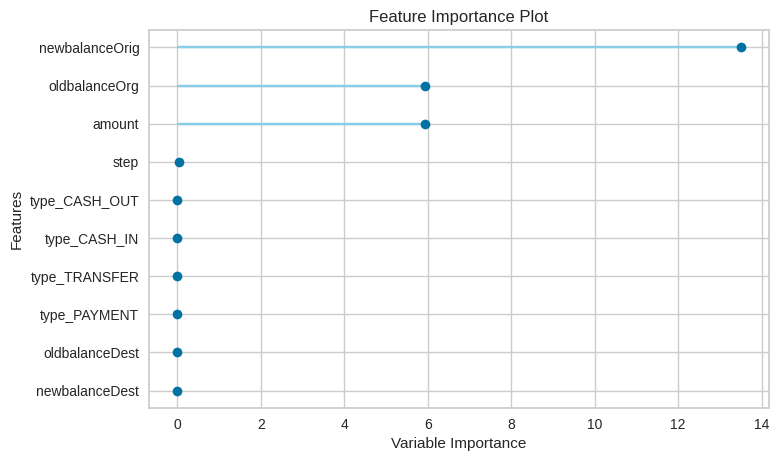

In [14]:
plot_model(loaded_model, plot = "feature")

Running app for actual prediction

In [ ]:
create_app(loaded_model)